## Data cleaning 

In [2]:
import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [3]:
#import the data from a csv-file
df = pd.read_csv('data/eda.csv')

### Visualize descriptive statistics

In [4]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
price,21597.00,540296.57,367368.14,78000.00,322000.00,450000.00,645000.00,7700000.00
id,21597.00,4580474287.77,2876735715.75,1000102.00,2123049175.00,3904930410.00,7308900490.00,9900000190.00
bedrooms,21597.00,3.37,0.93,1.00,3.00,3.00,4.00,33.00
bathrooms,21597.00,2.12,0.77,0.50,1.75,2.25,2.50,8.00
sqft_living,21597.00,2080.32,918.11,370.00,1430.00,1910.00,2550.00,13540.00
sqft_lot,21597.00,15099.41,41412.64,520.00,5040.00,7618.00,10685.00,1651359.00
floors,21597.00,1.49,0.54,1.00,1.00,1.50,2.00,3.50
waterfront,19206.00,0.01,0.09,0.00,0.00,0.00,0.00,1.00
view,21534.00,0.23,0.77,0.00,0.00,0.00,0.00,4.00
condition,21597.00,3.41,0.65,1.00,3.00,3.00,4.00,5.00


In [5]:
df.shape
#(21597, 21)

(21597, 21)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           21597 non-null  object 
 1   price          21597 non-null  float64
 2   id             21597 non-null  int64  
 3   bedrooms       21597 non-null  float64
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  float64
 6   sqft_lot       21597 non-null  float64
 7   floors         21597 non-null  float64
 8   waterfront     19206 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  float64
 13  sqft_basement  21145 non-null  float64
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17749 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

### Classify features into numerical and categorical

In [7]:
numerical_features = df.select_dtypes(include=[np.number]).columns.tolist()

# Identify categorical features (for simplicity, we are considering non-numerical columns and some numerical columns that are actually categorical)
categorical_features = df.select_dtypes(include=[object]).columns.tolist()
categorical_features += ['waterfront', 'view', 'condition', 'grade', 'zipcode']
#the date is not numerical or categorical
categorical_features.remove('date')

# Remove categorical features from numerical features list
numerical_features = [feature for feature in numerical_features if feature not in categorical_features]
numerical_features.remove('id')  # Remove 'id' column if present
print("Numerical Features:")
print(numerical_features)

print("\nCategorical Features:")
print(categorical_features)

Numerical Features:
['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'lat', 'long', 'sqft_living15', 'sqft_lot15']

Categorical Features:
['waterfront', 'view', 'condition', 'grade', 'zipcode']


## Look into duplicate values 

In [8]:
df.duplicated().value_counts()



False    21597
Name: count, dtype: int64

&rarr; there are no duplicated values 

## Look into missing values 


<Axes: >

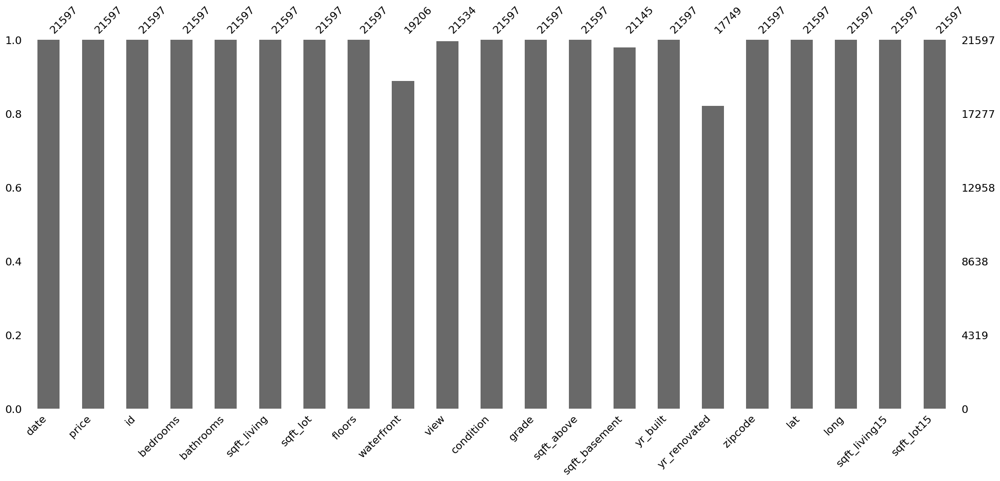

In [9]:
# import missingno
import missingno as msno
# display number of missing values per column
df.isna().sum()
# plotting percentage of missing values per column
msno.bar(df)

<Axes: >

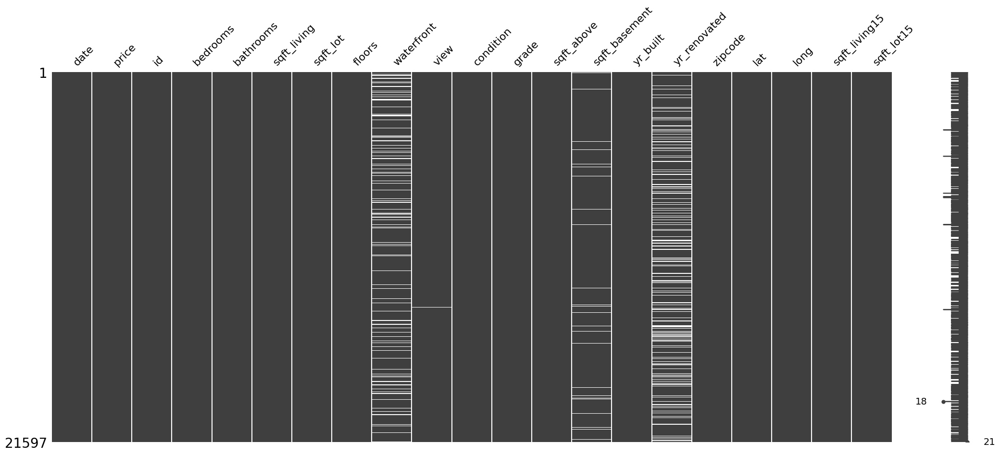

In [10]:
msno.matrix(df)

In [36]:
#checking for missing values
missing_values_count = df.isna().sum()

# Calculate the percentage of missing values per column
total_values = df.shape[0]  # Total number of rows in the DataFrame
percentage_missing_values = (missing_values_count / total_values) * 100

# Display the percentages of missing values per column
print("Percentage of missing values per column:")
print(percentage_missing_values)

Percentage of missing values per column:
date            0.00
price           0.00
id              0.00
bedrooms        0.00
bathrooms       0.00
sqft_living     0.00
sqft_lot        0.00
floors          0.00
waterfront      0.00
view            0.00
condition       0.00
grade           0.00
sqft_above      0.00
yr_built        0.00
yr_renovated    0.00
zipcode         0.00
lat             0.00
long            0.00
sqft_living15   0.00
sqft_lot15      0.00
renovated       0.00
month           0.00
dtype: float64


The missing values are :
- waterfront      11.07%
- view             0.29%
- sqft_basement    2.09%
- yr_renovated     17.82%  : this is probably due to the fact that those properties where not renovated &rarr; i will be replacing those with 0


### Outliers identification:

#### Visual Inspection (Box Plot)

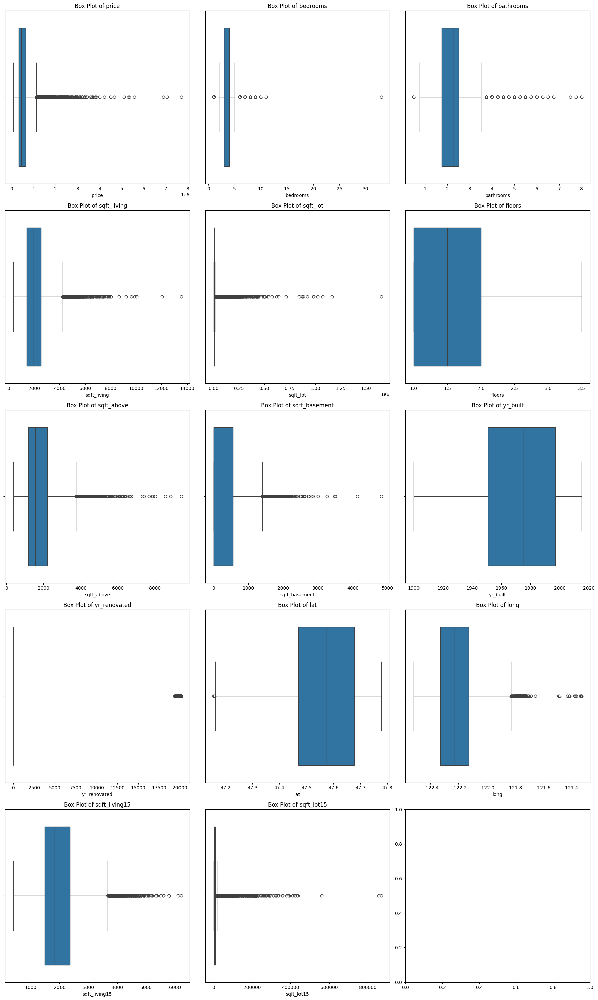

In [12]:
# Generate box plots for all numerical features using subplots
num_plots = len(numerical_features)
num_cols = 3  # Number of columns for subplots
num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate number of rows needed

fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, num_rows * 6))

for i, feature in enumerate(numerical_features):
    row = i // num_cols
    col = i % num_cols
    sns.boxplot(x=df[feature], ax=axes[row, col])
    axes[row, col].set_title(f'Box Plot of {feature}')
    axes[row, col].set_xlabel(feature)

# Adjust layout
plt.tight_layout()
plt.show()

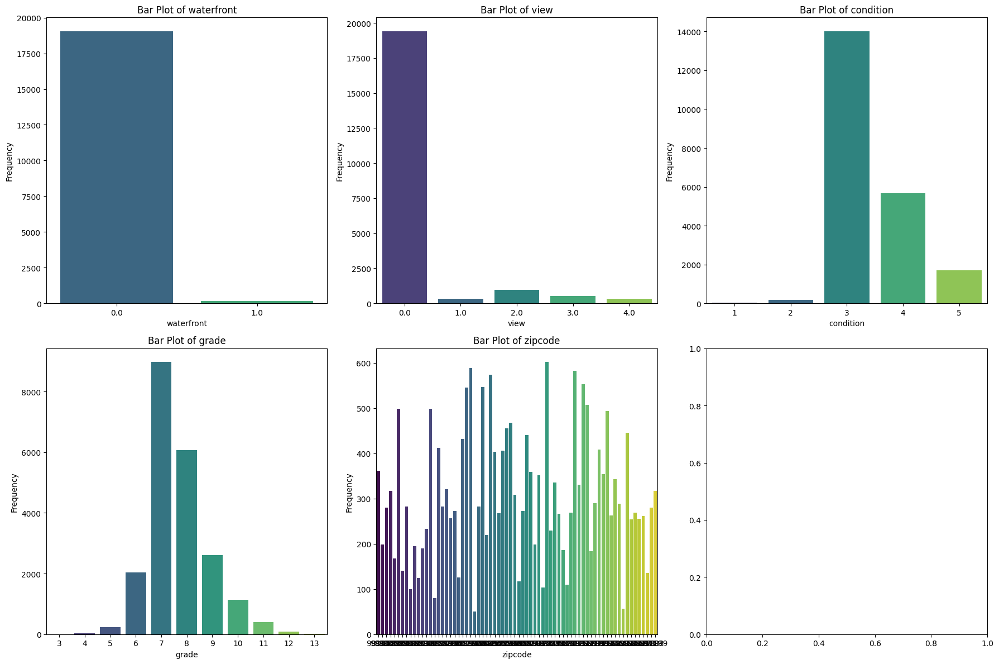

In [13]:

# Generate bar plots for all categorical features 
num_plots = len(categorical_features)
num_cols = 3  # Number of columns for subplots
num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate number of rows needed

fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, num_rows * 6))

for i, feature in enumerate(categorical_features):
    row = i // num_cols
    col = i % num_cols
    sns.countplot(data=df, x=feature, palette="viridis", ax=axes[row, col])
    axes[row, col].set_title(f'Bar Plot of {feature}')
    axes[row, col].set_xlabel(feature)
    axes[row, col].set_ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.show()

In [14]:
df.head()

,date,price,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,2014-10-13,221900.00,7129300520,3.00,1.00,1180.00,5650.00,1.00,NaN,0.00,...,7,1180.00,0.00,1955,0.00,98178,47.51,-122.26,1340.00,5650.00
1,2014-12-09,538000.00,6414100192,3.00,2.25,2570.00,7242.00,2.00,0.00,0.00,...,7,2170.00,400.00,1951,19910.00,98125,47.72,-122.32,1690.00,7639.00
2,2015-02-25,180000.00,5631500400,2.00,1.00,770.00,10000.00,1.00,0.00,0.00,...,6,770.00,0.00,1933,NaN,98028,47.74,-122.23,2720.00,8062.00
3,2014-12-09,604000.00,2487200875,4.00,3.00,1960.00,5000.00,1.00,0.00,0.00,...,7,1050.00,910.00,1965,0.00,98136,47.52,-122.39,1360.00,5000.00
4,2015-02-18,510000.00,1954400510,3.00,2.00,1680.00,8080.00,1.00,0.00,0.00,...,8,1680.00,0.00,1987,0.00,98074,47.62,-122.05,1800.00,7503.00


 ### Z-Score Method

In [15]:
"""

# Calculate Z-scores for each numerical feature
z_score_threshold = 3
outliers = pd.DataFrame()
df_zscore=df.copy()
for feature in numerical_features:
    # Calculate Z-scores
    z_scores = zscore(df_zscore[feature])
    
    # Identify outliers
    df_zscore[f'{feature}_z_score'] = z_scores
    feature_outliers = df_zscore[np.abs(z_scores) > z_score_threshold]
    
    # Append outliers to the DataFrame
    outliers = pd.concat([outliers, feature_outliers], axis=0, ignore_index=True)

# Display outliers
print(f"Total outliers detected using Z-score method: {len(outliers)}")
print(outliers.head())

# Visualize outliers for each numerical feature
plt.figure(figsize=(16, 10))
for i, feature in enumerate(numerical_features):
    plt.subplot(len(numerical_features)//2 + 1, 2, i + 1)
    sns.histplot(df_zscore[feature], kde=True, bins=50, color='skyblue', edgecolor='black')
    plt.title(f'Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.axvline(x=outliers[feature].min(), color='red', linestyle='dashed', linewidth=2)
    plt.axvline(x=outliers[feature].max(), color='red', linestyle='dashed', linewidth=2)
plt.tight_layout()
plt.show()"""

'\n\n# Calculate Z-scores for each numerical feature\nz_score_threshold = 3\noutliers = pd.DataFrame()\ndf_zscore=df.copy()\nfor feature in numerical_features:\n    # Calculate Z-scores\n    z_scores = zscore(df_zscore[feature])\n    \n    # Identify outliers\n    df_zscore[f\'{feature}_z_score\'] = z_scores\n    feature_outliers = df_zscore[np.abs(z_scores) > z_score_threshold]\n    \n    # Append outliers to the DataFrame\n    outliers = pd.concat([outliers, feature_outliers], axis=0, ignore_index=True)\n\n# Display outliers\nprint(f"Total outliers detected using Z-score method: {len(outliers)}")\nprint(outliers.head())\n\n# Visualize outliers for each numerical feature\nplt.figure(figsize=(16, 10))\nfor i, feature in enumerate(numerical_features):\n    plt.subplot(len(numerical_features)//2 + 1, 2, i + 1)\n    sns.histplot(df_zscore[feature], kde=True, bins=50, color=\'skyblue\', edgecolor=\'black\')\n    plt.title(f\'Distribution of {feature}\')\n    plt.xlabel(feature)\n    plt.yl

In [16]:
df.head()

,date,price,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,2014-10-13,221900.00,7129300520,3.00,1.00,1180.00,5650.00,1.00,NaN,0.00,...,7,1180.00,0.00,1955,0.00,98178,47.51,-122.26,1340.00,5650.00
1,2014-12-09,538000.00,6414100192,3.00,2.25,2570.00,7242.00,2.00,0.00,0.00,...,7,2170.00,400.00,1951,19910.00,98125,47.72,-122.32,1690.00,7639.00
2,2015-02-25,180000.00,5631500400,2.00,1.00,770.00,10000.00,1.00,0.00,0.00,...,6,770.00,0.00,1933,NaN,98028,47.74,-122.23,2720.00,8062.00
3,2014-12-09,604000.00,2487200875,4.00,3.00,1960.00,5000.00,1.00,0.00,0.00,...,7,1050.00,910.00,1965,0.00,98136,47.52,-122.39,1360.00,5000.00
4,2015-02-18,510000.00,1954400510,3.00,2.00,1680.00,8080.00,1.00,0.00,0.00,...,8,1680.00,0.00,1987,0.00,98074,47.62,-122.05,1800.00,7503.00


### looking fo inconcistances in the data 

Some of the renovation years have an extra 0 and are greater than 2024, which is not logical at all.


In [17]:
df[df["yr_renovated"]>2024].count()

date             744
price            744
id               744
bedrooms         744
bathrooms        744
sqft_living      744
sqft_lot         744
floors           744
waterfront       652
view             743
condition        744
grade            744
sqft_above       744
sqft_basement    723
yr_built         744
yr_renovated     744
zipcode          744
lat              744
long             744
sqft_living15    744
sqft_lot15       744
dtype: int64

## Some feature engineering

### replace the missing values

In [18]:
#replace all missing renovation years with 0/ it could also be replaced with construction date ?? would that be better ?
df['yr_renovated'].fillna(0, inplace=True)
#replace the view 
df['view'].fillna(method='ffill', inplace=True)
df["waterfront"].unique()
# the output is ([nan,  0.,  1.])
# Replace NaN values with a separate category 
# (e.g., -1 or 'Unknown')
df['waterfront'].fillna(-1, inplace=True)
#we can drop the view and the waterfront column
df["view"].unique()

array([0., 3., 4., 2., 1.])

Based on primary assumptions, the size of the basement does not seem to be important information and does not appear to add significant value. For now, I will choose to replace the missing values with the mean (average size). If this column is not needed in future analysis, it will be deleted.

### Convert the dates from string to Date typs 

In [19]:
type(df['date'][0])

# the date is saved as a string 
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d')
type(df['date'][0])
# the data is now of type pandas._libs.tslibs.timestamps.Timestamp

pandas._libs.tslibs.timestamps.Timestamp

### Convert the view column from float to int 

In [20]:
# Convert to integer
df['view'] = df['view'].astype(int)


### Convert the   waterfront column from float to int 

In [21]:
# Convert float_column to int
df['waterfront'] = df['waterfront'].astype(int)

### Convert the yr renovated column from float to int 

In [22]:
# Convert float_column to int
df['yr_renovated'] = df['yr_renovated'].astype(int)

#### Create a new column to indicate whether a house has been renovated (1 for renovated, 0 for non-renovated).

In [23]:
df['renovated'] = df['yr_renovated'].apply(lambda x: 1 if x > 0 else 0)


### create a new column to indicate the month s number

In [24]:
df['month'] = df['date'].dt.month

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   id             21597 non-null  int64         
 3   bedrooms       21597 non-null  float64       
 4   bathrooms      21597 non-null  float64       
 5   sqft_living    21597 non-null  float64       
 6   sqft_lot       21597 non-null  float64       
 7   floors         21597 non-null  float64       
 8   waterfront     21597 non-null  int64         
 9   view           21597 non-null  int64         
 10  condition      21597 non-null  int64         
 11  grade          21597 non-null  int64         
 12  sqft_above     21597 non-null  float64       
 13  sqft_basement  21145 non-null  float64       
 14  yr_built       21597 non-null  int64         
 15  yr_renovated   2159

### Fix the renovation dates to make them more logical.


In [26]:
df['yr_renovated'] = df['yr_renovated'].apply(lambda x: x // 10 if len(str(x)) == 5 and str(x).endswith('0') else x)
df[df["yr_renovated"]>2024].count()

date             0
price            0
id               0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
renovated        0
month            0
dtype: int64

#### drop sqft_basement


In [27]:
df = df.drop(columns=['sqft_basement'])

## define an expencive house

In [28]:
mean_price = df['price'].mean()
median_price = df['price'].median()
q1 = df['price'].quantile(0.25)
q3 = df['price'].quantile(0.75)

# Define expensive houses (above 75th percentile)
expensive_threshold = q3
expensive_houses = df[df['price'] > expensive_threshold]


In [35]:
print(q3)

645000.0


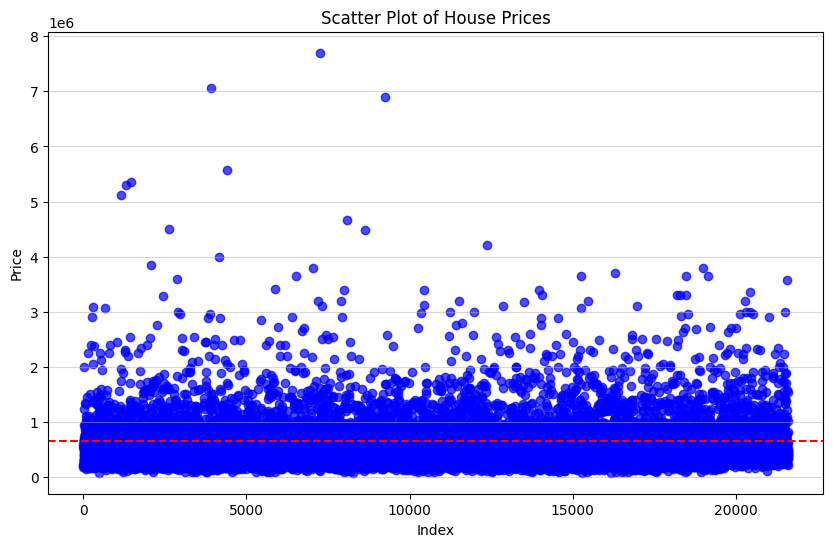

In [29]:
# Plotting scatter plot of house prices
plt.figure(figsize=(10, 6))
plt.scatter(np.arange(len(df)), df['price'], color='blue', alpha=0.7)
plt.title('Scatter Plot of House Prices')
plt.xlabel('Index')
plt.ylabel('Price')
plt.axhline(y=q3, color='red', linestyle='--', label=f'Threshold: ${600000}')

plt.grid(axis='y', alpha=0.5)
plt.show()

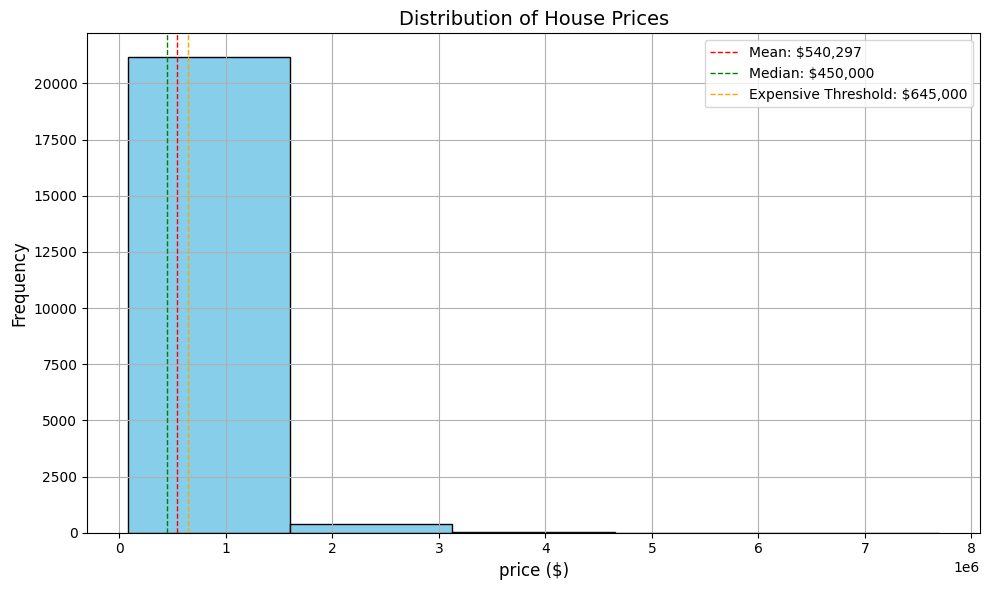

In [30]:


# Plot house prices
plt.figure(figsize=(10, 6))
plt.hist(df['price'], bins=5, color='skyblue', edgecolor='black')
plt.axvline(mean_price, color='red', linestyle='dashed', linewidth=1, label=f'Mean: ${mean_price:,.0f}')
plt.axvline(median_price, color='green', linestyle='dashed', linewidth=1, label=f'Median: ${median_price:,.0f}')
plt.axvline(expensive_threshold, color='orange', linestyle='dashed', linewidth=1, label=f'Expensive Threshold: ${expensive_threshold:,.0f}')
plt.xlabel('price ($)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.title('Distribution of House Prices', fontsize=14)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



## Define central zip codes 

### showing map results 


In [33]:
!pip install folium


[notice] A new release of pip available: 22.3.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [34]:
import folium
from folium.plugins import HeatMap
from geopy.distance import great_circle
import math
import pandas as pd

king_county_center = (47.6062, -122.3321)  # Example coordinates (Seattle, WA)

# Define the radius in kilometers
radius_km = 10  # Example radius in kilometers (10 miles)

# Initialize a folium map centered at the King County center coordinates
m = folium.Map(location=king_county_center, zoom_start=10)

# Add circular boundary to the map
folium.Circle(
    location=king_county_center,
    radius=radius_km * 1000,  # Convert radius to meters
    color='red',
    fill=True,
    fill_opacity=0.2,
    opacity=0.5,
).add_to(m)

# Add house price markers to the map
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=5,
        popup=f'Price: ${row["price"]:,}\nLiving Area: {row["sqft_living"]} sqft\nGrade: {row["grade"]}\nBathrooms: {row["bathrooms"]}',
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.4
    ).add_to(m)

# Save the map as an HTML file
m.save('houses_in_king_county.html')

# Display the map in a Jupyter Notebook
m

In [ ]:
king_county_center = (47.6062, -122.3321)  # Example coordinates (Seattle, WA)

# Define the radius in kilometers
radius_km = 10  # Example radius in kilometers (10 miles)

# Function to calculate distance in kilometers between two points
def distance_to_center(lat, long):
    return great_circle((lat, long), king_county_center).kilometers

# Filter houses within the radius
houses_in_center = df[df.apply(lambda row: distance_to_center(row['lat'], row['long']), axis=1) <= radius_km]
houses_in_center.shape


(5618, 22)

based on the zip code list and the expensive houses df we will create a new DF containing expensive houses in central areas 

now after getting the most expensive houses in the central are we are storing that in a new csv file that is going to be the base for the next steps 

In [ ]:
houses_in_center.to_csv('data/central_area_expensive_houses.csv', index=False)